# Рынок заведений общественного питания Москвы

**Описание проекта**

Инвесторы из фонда «Shut Up and Take My Money» решили попробовать себя в новой области и открыть заведение общественного питания в Москве. Заказчики ещё не знают, что это будет за место: кафе, ресторан, пиццерия, паб или бар, — и какими будут расположение, меню и цены.

Требуется подготовить исследование рынка Москвы, найти интересные особенности и презентовать полученные результаты, которые в будущем помогут в выборе подходящего инвесторам места.

**Входные данные:**

Доступен датасет с заведениями общественного питания Москвы, составленный на основе данных сервисов Яндекс Карты и Яндекс Бизнес на лето 2022 года. Информация, размещённая в сервисе Яндекс Бизнес, могла быть добавлена пользователями или найдена в общедоступных источниках. Она носит исключительно справочный характер.

**Цели работы:**

* Выявление интересных особенностей на рынке общественного питания Москвы.
* Подготовка рекомендаций по выбору места для открытия заведений общественного питания Москвы.
* Подготовка рекомендаций по выбору типа заведения общественного питания в Москве для его открытия.
* Подготовка рекомендаций по стоимости среднего чека в планируемом заведении.

**План работы:**

* Подготовка данных для анализа
* Изучение данных, проверка их на наличие выбросов
* Определение распределения заведений по категориям
* Определение популярных типов заведений
* Определение среднего количества посадочных мест, в зависимости от типа заведений
* Определение типов сетевых заведений
* Определение Топ-15 популярных заведений
* Определение количества заведений по категориям и районам Москвы
* Визуализация распределения средних рейтингов по категориям заведений
* Построение фоновой картограммы (хороплета) со средним рейтингом заведений каждого района
* Поиск топ-15 улиц по количеству заведений
* Поиск улиц, на которых находится только один объект общепита
* Формирование общих выводов по части анализа датасета
* Детализация исследования: открытие кофейни - формирование рекомендаций инвесторам
* Подготовка презентации

**Импортирую библиотеки:**

In [1]:
import pandas as pd
import seaborn as sns
import numpy as np
import datetime as dt
from scipy import stats as st
import math as mth
from plotly import graph_objects as go
#import plotly.graph_objects as go
from matplotlib import pyplot as plt
import plotly.express as px 
import scipy.stats as stats
# импортируем карту и хороплет
from folium import Map, Choropleth
# подключаем библиотеку
from folium import Marker
# импортируем кластер
from folium.plugins import MarkerCluster
# подключаю вывод на экран всплывающих названий районов на хороплёте
from folium import GeoJsonTooltip
# загружаю pdf
from IPython.display import IFrame

## Изучим общую информацию о данных

In [2]:
# Читаем csv-файл с помощью pandas:
try:
    moscow_places = pd.read_csv('/datasets/moscow_places.csv')
except:
    moscow_places = pd.read_csv('https://code.s3.yandex.net/datasets/moscow_places.csv')

**Знакомлюсь с данными:**

In [3]:
pd.options.display.max_colwidth = 130

display(moscow_places.head(5));

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
0,WoWфли,кафе,"Москва, улица Дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,NaN,NaN,NaN,NaN,0,NaN
1,Четыре комнаты,ресторан,"Москва, улица Дыбенко, 36, корп. 1",Северный административный округ,"ежедневно, 10:00–22:00",55.875801,37.484479,4.5,выше среднего,Средний счёт:1500–1600 ₽,1550.0,NaN,0,4.0
2,Хазри,кафе,"Москва, Клязьминская улица, 15",Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00–02:00",55.889146,37.525901,4.6,средние,Средний счёт:от 1000 ₽,1000.0,NaN,0,45.0
3,Dormouse Coffee Shop,кофейня,"Москва, улица Маршала Федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,NaN,Цена чашки капучино:155–185 ₽,NaN,170.0,0,NaN
4,Иль Марко,пиццерия,"Москва, Правобережная улица, 1Б",Северный административный округ,"ежедневно, 10:00–22:00",55.881166,37.449357,5.0,средние,Средний счёт:400–600 ₽,500.0,NaN,1,148.0


**Описание данных**

Файл moscow_places.csv:
    
* name — название заведения;
* address — адрес заведения;
* category — категория заведения, например «кафе», «пиццерия» или «кофейня»;
* hours — информация о днях и часах работы;
* lat — широта географической точки, в которой находится заведение;
* lng — долгота географической точки, в которой находится заведение;
* rating — рейтинг заведения по оценкам пользователей в Яндекс Картах (высшая оценка — 5.0);
* price — категория цен в заведении, например «средние», «ниже среднего», «выше среднего» и так далее;
* avg_bill — строка, которая хранит среднюю стоимость заказа в виде диапазона, например:
«Средний счёт: 1000–1500 ₽»;
«Цена чашки капучино: 130–220 ₽»;
«Цена бокала пива: 400–600 ₽».
и так далее;
* middle_avg_bill — число с оценкой среднего чека, которое указано только для значений из столбца avg_bill, начинающихся с подстроки «Средний счёт»:
Если в строке указан ценовой диапазон из двух значений, в столбец войдёт медиана этих двух значений.
Если в строке указано одно число — цена без диапазона, то в столбец войдёт это число.
Если значения нет или оно не начинается с подстроки «Средний счёт», то в столбец ничего не войдёт.
* middle_coffee_cup — число с оценкой одной чашки капучино, которое указано только для значений из столбца avg_bill, начинающихся с подстроки «Цена одной чашки капучино»:
Если в строке указан ценовой диапазон из двух значений, в столбец войдёт медиана этих двух значений.
Если в строке указано одно число — цена без диапазона, то в столбец войдёт это число.
Если значения нет или оно не начинается с подстроки «Цена одной чашки капучино», то в столбец ничего не войдёт.
* chain — число, выраженное 0 или 1, которое показывает, является ли заведение сетевым (для маленьких сетей могут встречаться ошибки):
0 — заведение не является сетевым
1 — заведение является сетевым
* district — административный район, в котором находится заведение, например Центральный административный округ;
* seats — количество посадочных мест.

**Изучаю общую информацию о датасете:**

In [4]:
moscow_places.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8406 entries, 0 to 8405
Data columns (total 14 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   name               8406 non-null   object 
 1   category           8406 non-null   object 
 2   address            8406 non-null   object 
 3   district           8406 non-null   object 
 4   hours              7870 non-null   object 
 5   lat                8406 non-null   float64
 6   lng                8406 non-null   float64
 7   rating             8406 non-null   float64
 8   price              3315 non-null   object 
 9   avg_bill           3816 non-null   object 
 10  middle_avg_bill    3149 non-null   float64
 11  middle_coffee_cup  535 non-null    float64
 12  chain              8406 non-null   int64  
 13  seats              4795 non-null   float64
dtypes: float64(6), int64(1), object(7)
memory usage: 919.5+ KB


In [5]:
moscow_places['name'].nunique()

5614

* В данных без предобработки представлено 5614 заведений. После предобработки их количество может уменьшиться.
* Данным требуется предобработка и изменение типов, так как в исходном датасете есть нарушение snake_case и пропуски, а так же типы некоторых данных не подойдут для дальнейшей работы без предварительной обработки. Недостатки данных, скорее всего, вызваны человеческим фактором.

In [6]:
def data_info(df):
    print(df.info())
    print('Доля пропусков: ', df.isna().mean())
    print('Полных дубликатов: ', df.duplicated().sum())
    print(f'Исходный датафрейм содержит: {df.shape[0]} строк')

In [7]:
data_info(moscow_places);

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8406 entries, 0 to 8405
Data columns (total 14 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   name               8406 non-null   object 
 1   category           8406 non-null   object 
 2   address            8406 non-null   object 
 3   district           8406 non-null   object 
 4   hours              7870 non-null   object 
 5   lat                8406 non-null   float64
 6   lng                8406 non-null   float64
 7   rating             8406 non-null   float64
 8   price              3315 non-null   object 
 9   avg_bill           3816 non-null   object 
 10  middle_avg_bill    3149 non-null   float64
 11  middle_coffee_cup  535 non-null    float64
 12  chain              8406 non-null   int64  
 13  seats              4795 non-null   float64
dtypes: float64(6), int64(1), object(7)
memory usage: 919.5+ KB
None
Доля пропусков:  name                 0.000000
category 

<a id='section_id'></a> 
## Предобработка данных 

**Проверяю названия столбцов:**

In [8]:
moscow_places.columns

Index(['name', 'category', 'address', 'district', 'hours', 'lat', 'lng',
       'rating', 'price', 'avg_bill', 'middle_avg_bill', 'middle_coffee_cup',
       'chain', 'seats'],
      dtype='object')

Названия столбцов меня устраивают.

**Привожу к регистру snake_case значения в столбцах с типом object:**

In [9]:
#Этот кусок кода себе на будущее сохраню тут. Может пригодиться.

#df['name'] = df['name'].str.replace('_', ' ').str.replace('-', ' ').str.replace('.', ' ').str.replace('/', ' ').str.replace('&', '')

In [10]:
for i in moscow_places.columns[0:3]: 
    moscow_places[i] = moscow_places[i].str.lower().str.replace(' ','_')

In [11]:
for i in moscow_places.columns[8:9]: 
    moscow_places[i] = moscow_places[i].str.lower().str.replace(' ','_')

In [12]:
moscow_places['address'] = moscow_places['address'].str.replace(' ','_')

In [13]:
display(moscow_places.head(5));

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
0,wowфли,кафе,"москва,_улица_дыбенко,_7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,NaN,NaN,NaN,NaN,0,NaN
1,четыре_комнаты,ресторан,"москва,_улица_дыбенко,_36,_корп._1",Северный административный округ,"ежедневно, 10:00–22:00",55.875801,37.484479,4.5,выше_среднего,Средний счёт:1500–1600 ₽,1550.0,NaN,0,4.0
2,хазри,кафе,"москва,_клязьминская_улица,_15",Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00–02:00",55.889146,37.525901,4.6,средние,Средний счёт:от 1000 ₽,1000.0,NaN,0,45.0
3,dormouse_coffee_shop,кофейня,"москва,_улица_маршала_федоренко,_12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,NaN,Цена чашки капучино:155–185 ₽,NaN,170.0,0,NaN
4,иль_марко,пиццерия,"москва,_правобережная_улица,_1б",Северный административный округ,"ежедневно, 10:00–22:00",55.881166,37.449357,5.0,средние,Средний счёт:400–600 ₽,500.0,NaN,1,148.0


**Ещё раз вывожу общую информацию:**

In [14]:
moscow_places.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8406 entries, 0 to 8405
Data columns (total 14 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   name               8406 non-null   object 
 1   category           8406 non-null   object 
 2   address            8406 non-null   object 
 3   district           8406 non-null   object 
 4   hours              7870 non-null   object 
 5   lat                8406 non-null   float64
 6   lng                8406 non-null   float64
 7   rating             8406 non-null   float64
 8   price              3315 non-null   object 
 9   avg_bill           3816 non-null   object 
 10  middle_avg_bill    3149 non-null   float64
 11  middle_coffee_cup  535 non-null    float64
 12  chain              8406 non-null   int64  
 13  seats              4795 non-null   float64
dtypes: float64(6), int64(1), object(7)
memory usage: 919.5+ KB


In [15]:
moscow_places.shape

(8406, 14)

**Проверяю "moscow_places" на наличие явных дубликатов:**

Меняю Ё на Е:

In [16]:
moscow_places['name'] = moscow_places['name'].str.replace('ё','е')

In [17]:
moscow_places.duplicated().sum()

0

Явных дубликатов по всему датафрейму не обнаружено. 🤷‍♂️

Попробую поискать дубликаты в названиях.

In [18]:
moscow_places['name'].duplicated().sum()

2900

Нашел 2900 дубликатов в наименованиях заведений. Но я не буду их удалять, так как заведения, являющиеся сетевыми, могут иметь одинаковые названия.

Попробую поискать дубликаты по паре "Наименование - Адрес".

In [19]:
moscow_places[moscow_places.duplicated(['name', 'address'])]

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
215,кафе,кафе,"москва,_парк_ангарские_пруды",Северный административный округ,"ежедневно, 10:00–22:00",55.881438,37.531848,3.2,NaN,NaN,NaN,NaN,0,NaN
1511,more_poke,ресторан,"москва,_волоколамское_шоссе,_11,_стр._2",Северный административный округ,"пн-чт 09:00–18:00; пт,сб 09:00–21:00; вс 09:00–18:00",55.806307,37.497566,4.2,NaN,NaN,NaN,NaN,1,188.0
2420,раковарня_клешни_и_хвосты,"бар,паб","москва,_проспект_мира,_118",Северо-Восточный административный округ,"пн-чт 12:00–00:00; пт,сб 12:00–01:00; вс 12:00–00:00",55.810677,37.638379,4.4,NaN,NaN,NaN,NaN,1,150.0
3109,хлеб_да_выпечка,кафе,"москва,_ярцевская_улица,_19",Западный административный округ,NaN,55.738449,37.410937,4.1,NaN,NaN,NaN,NaN,0,276.0


In [20]:
moscow_places.duplicated(['name', 'address']).sum()

4

Удалю 4 дубликата. Независимо от того, что удалится - это не должно повлиять на дальнейший анализ. Т.к. процент удаленных данных будет очень мал.

In [21]:
moscow_places = moscow_places.drop_duplicates(subset=['name', 'address'], keep='first')

Проверю, удалились-ли дубликаты и размер фатафрейма:

In [22]:
moscow_places.duplicated(['name', 'address']).sum()

0

Попробую поискать дубликаты другим способом:

In [23]:
moscow_places[moscow_places.duplicated(subset=['name','lat','lng'])]

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats


В столбцах 'name','lat','lng' явные дубликаты так же не найдены.

In [24]:
moscow_places.shape

(8402, 14)

**Поиск неявных дубликатов:**

**Удаляю найденные дубликаты:**

In [25]:
display(moscow_places['name'].unique());

array(['wowфли', 'четыре_комнаты', 'хазри', ..., 'миславнес', 'самовар',
       'kebab_time'], dtype=object)

In [26]:
moscow_places['name'].nunique()

5506

In [27]:
list(moscow_places['name'].sort_values(ascending=False).unique())

['яуза',
 'ясно',
 'ясмин',
 'яръ',
 'ярославский',
 'ярославна',
 'ярмарка_морских_блюд',
 'яркофе',
 'япоша',
 'японский_пес',
 'японский_король',
 'японские_традиции',
 'японская_кухня',
 'японамать',
 'янтарь',
 'янис',
 'яндекс_лавка',
 'яндекс_еда',
 'яндекс.лавка',
 'ян_примус',
 'ям_ям',
 'ялла',
 'ялва',
 'яккабаг',
 'я_щамс',
 'я_самурай!',
 'я_самарканд',
 'я_люблю_суши',
 'я_кофе',
 'я_в_тай!',
 'юрта',
 'юпитер',
 'юнус_халяль',
 'юность',
 'юма',
 'южный_порт',
 'южный_дворик',
 'южное',
 'южная_ночь',
 'югославия',
 'югос',
 'юг',
 'эшторил',
 'эчпочмак._татарские_пироги',
 'эфенди',
 'этокофе',
 'это_кофейня',
 'эти_вафли',
 'эстетика_вкусов',
 'эстетик',
 'эссе',
 'эспрессо_клуб',
 'эспрессо',
 'эскалоп',
 'эрна',
 'эрмитаж',
 'энтузиаст',
 'энесай',
 'эндорфин',
 'эндемик',
 'эльф',
 'эльнур',
 'эльба',
 'эль_кафе',
 'эль-шарк',
 'эллилагер',
 'элеонора',
 'эларджи',
 'экспедиция._северная_кухня',
 'эксмо',
 'эконяма',
 'эко_шаурма_халяль',
 'эко-буфет',
 'эклерная_кл

**Проверяю данные на наличие пропусков в каждом отдельном столбце:**

Визуализирую информацию о пропусках:

In [28]:
# пропущенные значения бары

def pass_value_barh(df):
    try:
        (
            (df.isna().mean()*100)
            .to_frame()
            .rename(columns = {0:'space'})
            .query('space > 0')
            .sort_values(by = 'space', ascending = True)
            .plot(kind = 'barh', figsize = (19,6), rot = 0, legend = False, fontsize = 16)
            .set_title('Наличие пропусков в колонках' + "\n", fontsize = 22, color = 'SteelBlue')    
        );    
    except:
        print('Пропусков не осталось или произошла ошибка в первой части функции.')

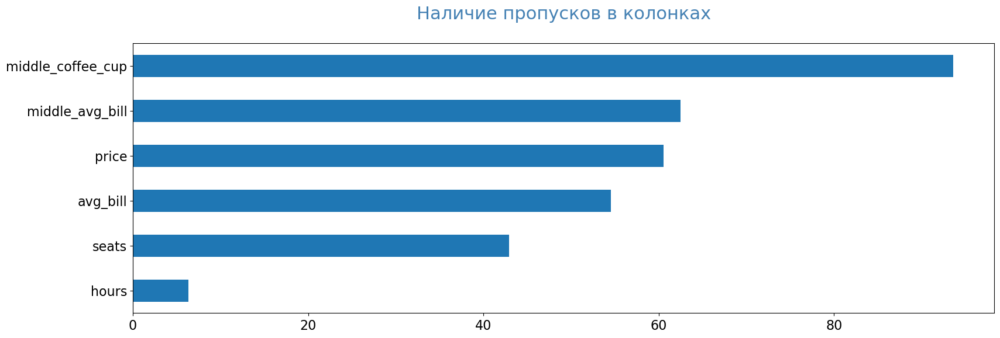

In [29]:
pass_value_barh(moscow_places)

И выведу точные количества пропусков по каждому столбцу:

In [30]:
moscow_places.isna().sum()

name                    0
category                0
address                 0
district                0
hours                 535
lat                     0
lng                     0
rating                  0
price                5087
avg_bill             4586
middle_avg_bill      5253
middle_coffee_cup    7867
chain                   0
seats                3610
dtype: int64

Пропуски имеются в 6 столбцах. Больше всего пропусков в столбце middle_coffee_cup.

In [31]:
omissions = pd.DataFrame(round(moscow_places.isna().mean().sort_values(ascending=False)*100,1)).style.background_gradient('coolwarm')

In [32]:
display(omissions);

,0
middle_coffee_cup,93.600000
middle_avg_bill,62.500000
price,60.500000
avg_bill,54.600000
seats,43.000000
hours,6.400000
name,0.000000
category,0.000000
address,0.000000
district,0.000000


В столбцах с пропусками
    
* middle_coffee_cup - число с оценкой одной чашки капучино, которое указано только для значений из столбца avg_bill
* middle_avg_bill - число с оценкой среднего чека, которое указано только для значений из столбца avg_bill
* price - категория цен в заведении, например «средние», «ниже среднего», «выше среднего»
* avg_bill - строка, которая хранит среднюю стоимость заказа в виде диапазона, например: «Средний счёт: 1000–1500 ₽»
* seats - количество посадочных мест
* hours - информация о днях и часах работы

Мы не можем заполнить пропуски, так как не владеем достоверной информацией и не можем корректно её спрогнозировать. 
Удалять пропуски так же считаю нецелесообразным из-за возможной потери большого количества полезной информации, что негативно скажется на результатах исследования.

In [33]:
moscow_places.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 8402 entries, 0 to 8405
Data columns (total 14 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   name               8402 non-null   object 
 1   category           8402 non-null   object 
 2   address            8402 non-null   object 
 3   district           8402 non-null   object 
 4   hours              7867 non-null   object 
 5   lat                8402 non-null   float64
 6   lng                8402 non-null   float64
 7   rating             8402 non-null   float64
 8   price              3315 non-null   object 
 9   avg_bill           3816 non-null   object 
 10  middle_avg_bill    3149 non-null   float64
 11  middle_coffee_cup  535 non-null    float64
 12  chain              8402 non-null   int64  
 13  seats              4792 non-null   float64
dtypes: float64(6), int64(1), object(7)
memory usage: 984.6+ KB


Типы данных мне кажутся корректным во всех столбцах, кроме seats, приведу seats к типу int64.

In [34]:
moscow_places['seats'] = moscow_places['seats'].astype('Int64')

Проверю, сработало-ли.

In [35]:
moscow_places.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 8402 entries, 0 to 8405
Data columns (total 14 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   name               8402 non-null   object 
 1   category           8402 non-null   object 
 2   address            8402 non-null   object 
 3   district           8402 non-null   object 
 4   hours              7867 non-null   object 
 5   lat                8402 non-null   float64
 6   lng                8402 non-null   float64
 7   rating             8402 non-null   float64
 8   price              3315 non-null   object 
 9   avg_bill           3816 non-null   object 
 10  middle_avg_bill    3149 non-null   float64
 11  middle_coffee_cup  535 non-null    float64
 12  chain              8402 non-null   int64  
 13  seats              4792 non-null   Int64  
dtypes: Int64(1), float64(5), int64(1), object(7)
memory usage: 992.8+ KB


Теперь с типами всё в порядке)

**Посмотрим, как распределены значения:**

**rating**

In [36]:
moscow_places['rating'].sort_values().unique()

array([1. , 1.1, 1.2, 1.3, 1.4, 1.5, 1.6, 1.7, 1.8, 1.9, 2. , 2.1, 2.2,
       2.3, 2.4, 2.5, 2.6, 2.7, 2.8, 2.9, 3. , 3.1, 3.2, 3.3, 3.4, 3.5,
       3.6, 3.7, 3.8, 3.9, 4. , 4.1, 4.2, 4.3, 4.4, 4.5, 4.6, 4.7, 4.8,
       4.9, 5. ])

В рейтинг все значения выглядят корректными.

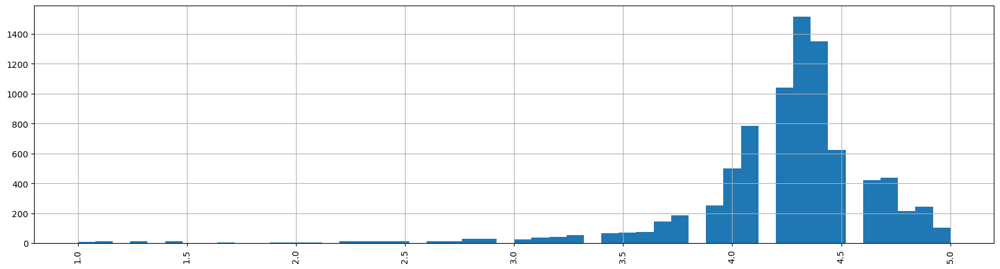

In [37]:
moscow_places['rating'].sort_values().hist(xrot=90, bins=50, figsize=(20, 5));

Похоже, что большинство заведений имеют рейтинг 4.3 и 4.4... Распределение выглядит нормальным. 🤨 посмотрим, что по другим столбцам.

**middle_avg_bill**

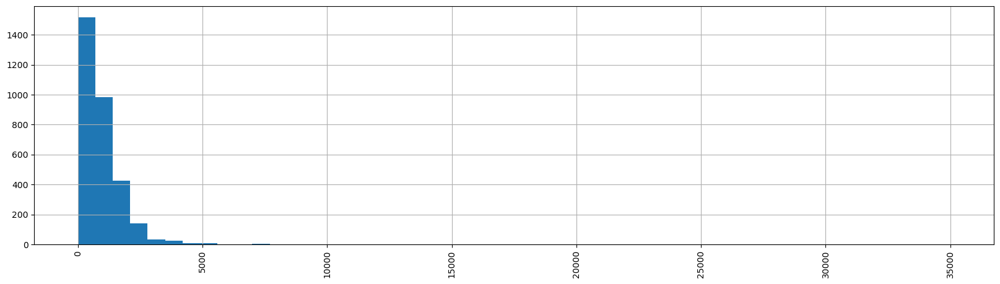

In [38]:
moscow_places['middle_avg_bill'].sort_values().hist(xrot=90, bins=50, figsize=(20, 5));

Средний чек в заведениях находится в пределях от 0 до 2500-3000.

In [39]:
moscow_places['middle_avg_bill'].describe()

count     3149.000000
mean       958.053668
std       1009.732845
min          0.000000
25%        375.000000
50%        750.000000
75%       1250.000000
max      35000.000000
Name: middle_avg_bill, dtype: float64

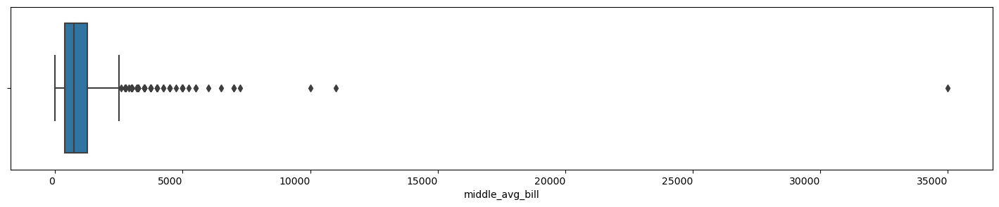

In [40]:
plt.figure(figsize=(18, 3))
sns.boxplot(x='middle_avg_bill', data=moscow_places)
sns.set_palette('dark') 
plt.xticks(ha='right');

Я думаю, что тут определенно нужно отсекать выбросы по 3 квантилю.

In [41]:
moscow_places.shape

(8402, 14)

moscow_places = moscow_places.query('middle_avg_bill <= 36000')

In [42]:
moscow_places.shape

(8402, 14)

In [43]:
share_of_losses = 100-(3149/8402*100)
share_of_losses

62.52082837419662

**middle_coffee_cup**

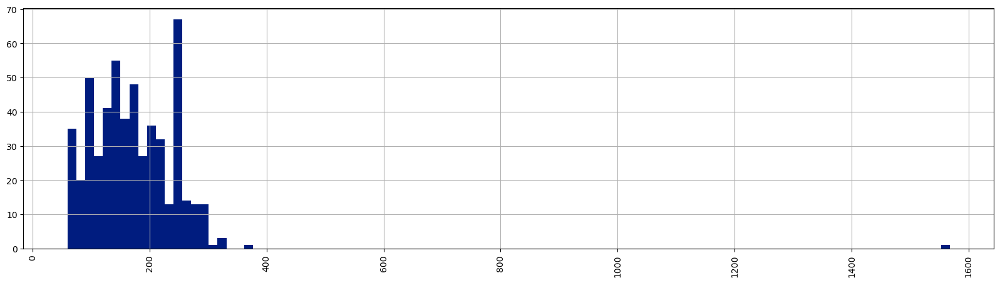

In [44]:
moscow_places['middle_coffee_cup'].sort_values().hist(xrot=90, bins=100, figsize=(20, 5));

Самая дешевая чашка кофе обойдётся в 60. И в основном кофе стоит от 60 до 300. Чаще 100-200. Медианное значение - 170.

In [45]:
moscow_places['middle_coffee_cup'].median()

169.0

In [46]:
moscow_places['middle_coffee_cup'].describe()

count     535.000000
mean      174.721495
std        88.951103
min        60.000000
25%       124.500000
50%       169.000000
75%       225.000000
max      1568.000000
Name: middle_coffee_cup, dtype: float64

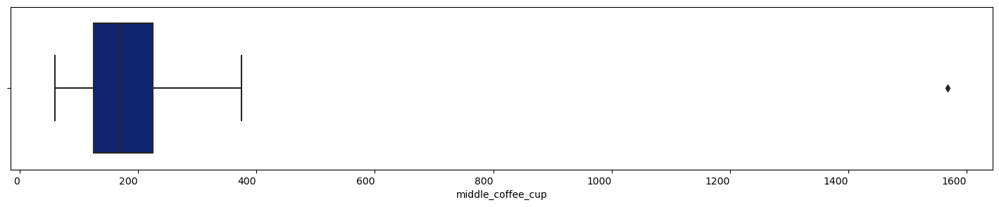

In [47]:
plt.figure(figsize=(18, 3))
sns.boxplot(x='middle_coffee_cup', data=moscow_places)
sns.set_palette('dark') 
plt.xticks(ha='right');

Тут тоже (в middle_coffee_cup) много выбросов!

**chain**

In [48]:
moscow_places['chain'].unique()

array([0, 1], dtype=int64)

В chain вроде хорошо всё.

**seats**

In [49]:
list(moscow_places['seats'].sort_values(ascending=False).unique())

[1288,
 1200,
 1040,
 920,
 760,
 675,
 660,
 650,
 644,
 625,
 600,
 585,
 500,
 495,
 491,
 481,
 480,
 478,
 455,
 450,
 430,
 428,
 420,
 400,
 398,
 380,
 356,
 350,
 343,
 330,
 326,
 320,
 310,
 308,
 307,
 306,
 305,
 300,
 295,
 290,
 287,
 286,
 280,
 276,
 275,
 273,
 270,
 268,
 266,
 252,
 250,
 247,
 246,
 245,
 240,
 239,
 236,
 232,
 230,
 229,
 228,
 226,
 225,
 220,
 217,
 215,
 214,
 212,
 210,
 208,
 206,
 202,
 200,
 198,
 195,
 192,
 190,
 189,
 188,
 187,
 185,
 184,
 180,
 178,
 176,
 175,
 174,
 173,
 170,
 168,
 167,
 166,
 165,
 164,
 161,
 160,
 159,
 158,
 157,
 155,
 154,
 151,
 150,
 148,
 147,
 146,
 145,
 144,
 143,
 141,
 140,
 138,
 135,
 133,
 132,
 131,
 130,
 128,
 127,
 126,
 125,
 124,
 122,
 120,
 118,
 116,
 115,
 114,
 113,
 112,
 110,
 108,
 107,
 106,
 105,
 104,
 102,
 100,
 99,
 98,
 97,
 96,
 95,
 94,
 93,
 92,
 90,
 88,
 87,
 86,
 85,
 84,
 83,
 82,
 81,
 80,
 79,
 78,
 77,
 76,
 75,
 74,
 72,
 70,
 69,
 68,
 67,
 66,
 65,
 64,
 63,
 62,

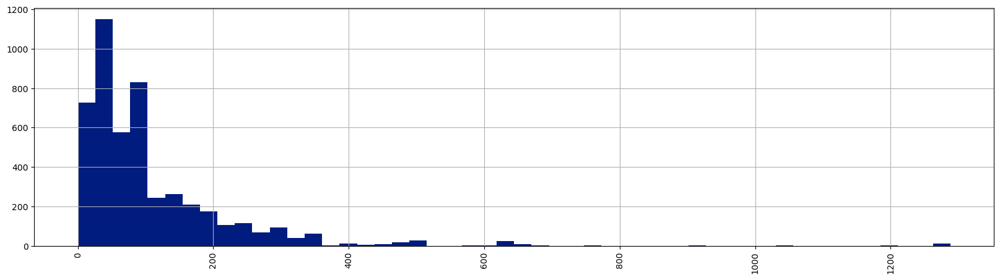

In [50]:
moscow_places['seats'].sort_values().hist(xrot=90, bins=50, figsize=(20, 5));

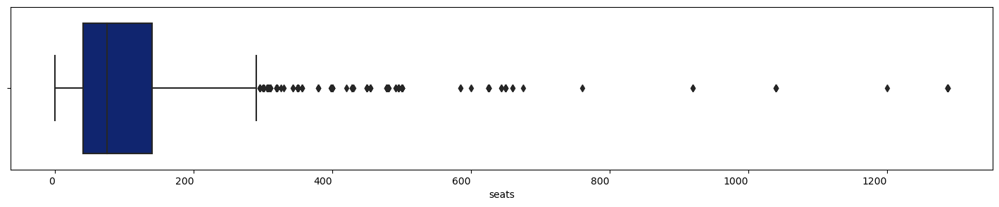

In [51]:
plt.figure(figsize=(18, 3))
sns.boxplot(x='seats', data=moscow_places)
sns.set_palette('dark') 
plt.xticks(ha='right');

Есть выбросы - доработаю их позже.

**Вывод по части предобработки данных:**

В процессе предварительного знакомства и предобработки были выявлены следующие недостатки в данных:

* Несоблюдение стиля snake_cake
* Наличие пропусков
* Наличие явных и неявных дубликатов
* Наличие выбросов в столбцах с числовыми значениями
* Некорректный тип данных в столбце seats

Всё это могло быть следствием ошибок, допущенных людьми при внесении данных. Выявленные недостатки не позволяют проводить анализ данных без предварительной обработки.

In [52]:
display(moscow_places.head(5));

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
0,wowфли,кафе,"москва,_улица_дыбенко,_7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,NaN,NaN,NaN,NaN,0,<NA>
1,четыре_комнаты,ресторан,"москва,_улица_дыбенко,_36,_корп._1",Северный административный округ,"ежедневно, 10:00–22:00",55.875801,37.484479,4.5,выше_среднего,Средний счёт:1500–1600 ₽,1550.0,NaN,0,4
2,хазри,кафе,"москва,_клязьминская_улица,_15",Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00–02:00",55.889146,37.525901,4.6,средние,Средний счёт:от 1000 ₽,1000.0,NaN,0,45
3,dormouse_coffee_shop,кофейня,"москва,_улица_маршала_федоренко,_12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,NaN,Цена чашки капучино:155–185 ₽,NaN,170.0,0,<NA>
4,иль_марко,пиццерия,"москва,_правобережная_улица,_1б",Северный административный округ,"ежедневно, 10:00–22:00",55.881166,37.449357,5.0,средние,Средний счёт:400–600 ₽,500.0,NaN,1,148


**Создадим столбец street с названиями улиц из столбца с адресом:**

In [53]:
moscow_places['street'] = moscow_places['address'].str.split(',_').apply(lambda x: x[1])

**Создадим столбец is_24/7 с обозначением, что заведение работает ежедневно и круглосуточно (24/7):**

* логическое значение True — если заведение работает ежедневно и круглосуточно;
* логическое значение False — в противоположном случае.

In [54]:
moscow_places['is_24/7'] = moscow_places['hours'].str.contains('круглосуточно', case=False) &\
moscow_places['hours'].str.contains('ежедневно', case=False)

In [55]:
display(moscow_places.head(5));

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24/7
0,wowфли,кафе,"москва,_улица_дыбенко,_7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,NaN,NaN,NaN,NaN,0,<NA>,улица_дыбенко,False
1,четыре_комнаты,ресторан,"москва,_улица_дыбенко,_36,_корп._1",Северный административный округ,"ежедневно, 10:00–22:00",55.875801,37.484479,4.5,выше_среднего,Средний счёт:1500–1600 ₽,1550.0,NaN,0,4,улица_дыбенко,False
2,хазри,кафе,"москва,_клязьминская_улица,_15",Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00–02:00",55.889146,37.525901,4.6,средние,Средний счёт:от 1000 ₽,1000.0,NaN,0,45,клязьминская_улица,False
3,dormouse_coffee_shop,кофейня,"москва,_улица_маршала_федоренко,_12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,NaN,Цена чашки капучино:155–185 ₽,NaN,170.0,0,<NA>,улица_маршала_федоренко,False
4,иль_марко,пиццерия,"москва,_правобережная_улица,_1б",Северный административный округ,"ежедневно, 10:00–22:00",55.881166,37.449357,5.0,средние,Средний счёт:400–600 ₽,500.0,NaN,1,148,правобережная_улица,False


In [56]:
moscow_places['is_24/7'].unique()

array([False,  True])

**Вывод по части предобработки данных:**

В процессе предварительного знакомства и предобработки были выявлены следующие недостатки в данных:

* Несоблюдение стиля snake_cake
* Наличие пропусков
* Наличие явных и неявных дубликатов
* Наличие выбросов в столбцах с числовыми значениями
* Некорректный тип данных в столбце seats

Всё это могло быть следствием ошибок, допущенных людьми при внесении данных. Выявленные недостатки не позволяют проводить анализ данных без предварительной обработки.

## Анализ данных

**Сделаем вывод о том, какие категории заведений представлены в данных. Исследуем количество объектов общественного питания по категориям: рестораны, кофейни, пиццерии, бары и так далее.**

In [57]:
# Количество заведений в разбивке по категориям:

categories = moscow_places.groupby('category').agg({'category': 'count'})
categories.columns = ['count']
categories = categories.sort_values(by='count', ascending=False)
display(categories);

,count
category,
кафе,2376
ресторан,2042
кофейня,1413
"бар,паб",764
пиццерия,633
быстрое_питание,603
столовая,315
булочная,256


**Построим визуализации. Ответим на вопрос о распределении заведений по категориям.**

In [58]:
fig = go.Figure(data=[go.Pie(labels=categories.index, values=categories['count'])])
fig.update_layout(title='Распределение заведений по категориям в долях')
fig.show()

Видно, что больше кафе, ресторанов и кофеен, а меньше булочных, столовых и заведений быстрого питания.

In [59]:
fig = px.bar(categories, x=categories.index, y='count', title='Распределение заведений по категориям')
fig.show()

Самым популярным типом заведений является кафе, самым менее популярным - булочная.

**Исследуем количество посадочных мест в местах по категориям: рестораны, кофейни, пиццерии, бары и так далее. Построим визуализации. Проанализируем результаты и сделаем выводы.**

In [60]:
# На количество мест сильнее всего влияет категория заведения, поэтому заполним пропуски 
# в этом поле медианным значением по каждой категории из столбца category.

for t in moscow_places['category'].unique():
    moscow_places.loc[(moscow_places['category'] == t) & (moscow_places['seats'].isna()), 'seats'] = \
    moscow_places.loc[(moscow_places['category'] == t), 'seats'].median().round().astype('int32')

moscow_places['seats'] = pd.to_numeric(moscow_places['seats'], errors='coerce', downcast='integer').astype('int32')

seats_by_categories = pd.pivot_table(data=moscow_places, index='category', values='seats', aggfunc='median').sort_values(by='seats', ascending=False)

display(seats_by_categories);

,seats
category,
ресторан,86
"бар,паб",82
кофейня,80
столовая,76
быстрое_питание,65
кафе,60
пиццерия,55
булочная,50


In [61]:
fig = px.bar(seats_by_categories, x=seats_by_categories.index, y='seats', title='Медианное количество посадочных мест в разбивке по типам заведений')
fig.show()

Самое большое медианное значение количества посадочных мест в ресторанах, самое меньшее в булочных.

**Рассмотрим и изобразим соотношение сетевых и несетевых заведений в датасете. Сделаем вывод о том каких заведений больше?**

In [62]:
fig = px.bar(categories, x=categories.index, y='count', title='Распределение заведений по категориям')
fig.show()

In [63]:
# строим гистограммы
fig = px.histogram(moscow_places, # загружаем данные
                   x='category', # указываем столбец с данными для оси X
                   color='chain', # обозначаем категорию для разделения цветом
                   title='Распределение заведений в разбивке по сетевым и не сетевым (0 - не сетевое, 1 - сетевое)', # указываем заголовок
                   nbins=50, # назначаем число корзин
                   barmode='overlay') # выбираем «полупрозрачный» тип отображения столбцов
fig.update_xaxes(title_text='Тип заведения') # подпись для оси X
fig.update_yaxes(title_text='Значение') # подпись для оси Y
fig.show() # выводим график

Не сетевых заведений чаще больше, чем сетевых по всем типам, кроме кофеен, пиццерий и булочных. Кофеен, пиццерий и будочных сетевых больше, но не намного, чем не сетевых.

In [64]:
# Строим гистограммы
fig = px.histogram(moscow_places, # загружаем данные
                   x='chain', # указываем столбец с данными для оси X
                   title='Распределение заведений в разбивке по сетевым и не сетевым (0 - не сетевое, 1 - сетевое)', # указываем заголовок
                   nbins=3, # назначаем число корзин
                   barmode='overlay') # выбираем «полупрозрачный» тип отображения столбцов
fig.update_xaxes(title_text='Тип заведения') # подпись для оси X
fig.update_yaxes(title_text='Значение') # подпись для оси Y
fig.show() # выводим график

In [65]:
mp_chain_1 = moscow_places.groupby(['category','chain']).agg(count=('name','count')).query('chain == 1').reset_index()

mp_chain_2 = moscow_places.groupby(['category'], as_index=False).agg(count=('name','count'))

mp_chain_1['ratio'] = (mp_chain_1['count']/mp_chain_2['count']).apply(lambda x: '{:.0%}'.format(x))

mp_chain_1.sort_values('ratio', ascending=False)

,category,chain,count,ratio
1,булочная,1,157,61%
5,пиццерия,1,330,52%
4,кофейня,1,720,51%
2,быстрое_питание,1,232,38%
6,ресторан,1,729,36%
3,кафе,1,779,33%
7,столовая,1,88,28%
0,"бар,паб",1,168,22%


In [66]:
fig = px.bar(mp_chain_1.sort_values('ratio'), 
             y='ratio', 
             x='category', 
             text='ratio',
             hover_data=['ratio'])


# оформляем график
fig.update_layout(title='Доля сетевых заведений по категориям',
                   yaxis_title='% сетевых заведений',
                   xaxis_title='Категории',
                   title_x = 0.5,
                   xaxis={'categoryorder': 'total descending'})



fig.show()

Сетевое распределение более характерно для булочных, пиццерий и кофеен и менее характерно для столовых и баров.

In [67]:
mp_by_chains = moscow_places.groupby('chain').agg({'name': 'count'})

display(mp_by_chains);

,name
chain,
0,5199
1,3203


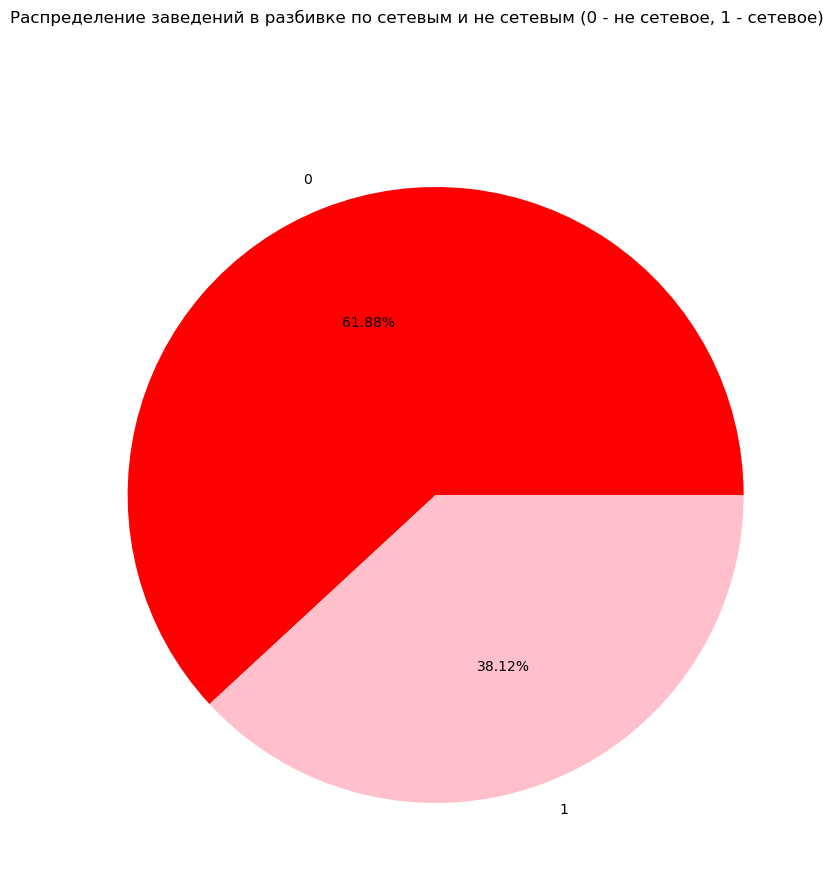

In [68]:
mp_by_chains.plot(kind='pie', 
                  y='name', 
                  autopct='%.2f%%', 
                  legend=False, 
                  figsize=(15, 10), 
                  colors = ['red', 'pink', 'steelblue'])

plt.suptitle('Распределение заведений в разбивке по сетевым и не сетевым (0 - не сетевое, 1 - сетевое)') # заголовок
plt.ylabel('')
plt.show()

Не сетевых заведений больше, чем сетевых.

**Сделаем вывод о том, какие категории заведений чаще являются сетевыми. Исследуем данные и ответьте на вопрос графиком.**

In [69]:
# Строим гистограммы
fig = px.histogram(moscow_places, # загружаем данные
                   x='category', # указываем столбец с данными для оси X
                   color='chain', # обозначаем категорию для разделения цветом
                   title='Распределение заведений в разбивке по сетевым и не сетевым (0 - не сетевое, 1 - сетевое)', # указываем заголовок
                   nbins=50, # назначаем число корзин
                   barmode='overlay') # выбираем «полупрозрачный» тип отображения столбцов
fig.update_xaxes(title_text='Тип заведения') # подпись для оси X
fig.update_yaxes(title_text='Значение') # подпись для оси Y
fig.show() # выводим график

Чаще сетевыми являются кафе, рестораны, бары, заведения быстрого питания и столовые.

**Попробую другой вариант - Гистограмму с накоплением:**

In [70]:
category_chain = (
    moscow_places.groupby(by=['category', 'chain'], as_index=False)
    .agg(name_count=('name', 'nunique'))
)


In [71]:
fig = px.bar(
    category_chain,
    x='category',
    y='name_count',
    color='chain',
    text='name_count'
)

fig.update_layout(
    title='Количество заведений по категориям (0 - не сетевое, 1 - сетевое)',
    xaxis_title='Категории',
    yaxis_title='Количество заведений в категории',
    xaxis={'categoryorder': 'total descending'}
)

fig.show()

По этому графику вывод следующий: Чаще сетевыми являются кафе, рестораны, кофейни и бары.

**Сгруппируем данные по названиям заведений и найдите топ-15 популярных сетей в Москве. Под популярностью понимается количество заведений этой сети в регионе. Построим подходящую для такой информации визуализацию. Выделим, который объединяет сети. Определим категории сетей.**

In [72]:
moscow_places['quantity'] = moscow_places.index
top_15 = moscow_places.groupby(by='name')['quantity'].count().sort_values(ascending=False).head(15).reset_index()
print('Top-15 Популярных заведений')

display(top_15);

Top-15 Популярных заведений


,name,quantity
0,кафе,188
1,шоколадница,120
2,домино'с_пицца,77
3,додо_пицца,74
4,one_price_coffee,72
5,яндекс_лавка,69
6,cofix,65
7,prime,50
8,хинкальная,44
9,шаурма,43


In [73]:
top = pd.pivot_table(data=moscow_places, index='name', values='quantity', aggfunc='count').sort_values(by='quantity', ascending=False).head(15).reset_index()
print('Top-15 Популярных заведений')
display(top);

Top-15 Популярных заведений


,name,quantity
0,кафе,188
1,шоколадница,120
2,домино'с_пицца,77
3,додо_пицца,74
4,one_price_coffee,72
5,яндекс_лавка,69
6,cofix,65
7,prime,50
8,хинкальная,44
9,шаурма,43


In [74]:
# Строю диаграмму с сегментами:

fig = go.Figure(data=[go.Pie(labels=top['name'], #Указываю значения, которые появятся на метках сегментов
                     values=top['quantity'],      #Указываю данные, которые отобразятся на графике
                     pull=[0.1, 0])])
fig.update_layout(title='Топ заведений по популярности',
                 width=800,
                 height=600,
                 annotations=[dict(x=1.12, #Вручную настраиваю аннотацию легенды
                                   y=1.05,
                                   text='Названия заведений',
                                   showarrow=False)]) 
fig.show() #Вывожу график

По диаграмме видно, что болльше всего заведений называются "Кафе" - их 188 штук или 19% от общего количества в Топ-15. На 15-м месте нашего топа находятся заведения с названием "Ресторан" - 34 заведения или 3,43% от Топ-15.

Конечно же мне известны почти все заведения из Топ-15. Особенно шаурма. Хотя заведений с названием "Шаурма" как-то мало. Возможно другие заведения этого типа просто имеют иные наименования.

Я думаю, что заведения из нашего топа относятся к сетевому типу, так как имеют схожие наименования. Или просто имеют одинаковые названия.

In [75]:
fig = px.bar(top_15, x='name', y='quantity', color_discrete_sequence=["yellow"])
fig.update_layout(title='Топ-15 заведений по популярности',
                  xaxis_title='Названия заведений',
                  yaxis_title='Количество заведений',
                  xaxis={'categoryorder': 'total descending'})
fig.show()

**Сделаем вывод о том, какие административные районы Москвы присутствуют в датасете? Отобразим общее количество заведений и количество заведений каждой категории по районам. Проиллюстрируем эту информацию одним графиком.**

In [76]:
display(moscow_places.head(5))

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24/7,quantity
0,wowфли,кафе,"москва,_улица_дыбенко,_7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,NaN,NaN,NaN,NaN,0,60,улица_дыбенко,False,0
1,четыре_комнаты,ресторан,"москва,_улица_дыбенко,_36,_корп._1",Северный административный округ,"ежедневно, 10:00–22:00",55.875801,37.484479,4.5,выше_среднего,Средний счёт:1500–1600 ₽,1550.0,NaN,0,4,улица_дыбенко,False,1
2,хазри,кафе,"москва,_клязьминская_улица,_15",Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00–02:00",55.889146,37.525901,4.6,средние,Средний счёт:от 1000 ₽,1000.0,NaN,0,45,клязьминская_улица,False,2
3,dormouse_coffee_shop,кофейня,"москва,_улица_маршала_федоренко,_12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,NaN,Цена чашки капучино:155–185 ₽,NaN,170.0,0,80,улица_маршала_федоренко,False,3
4,иль_марко,пиццерия,"москва,_правобережная_улица,_1б",Северный административный округ,"ежедневно, 10:00–22:00",55.881166,37.449357,5.0,средние,Средний счёт:400–600 ₽,500.0,NaN,1,148,правобережная_улица,False,4


**Сделаем вывод о том, какие административные районы Москвы присутствуют в датасете.**

In [77]:
print('В датасете присутствуют следующие административные районы Москвы:')

display(moscow_places['district'].unique());

В датасете присутствуют следующие административные районы Москвы:


array(['Северный административный округ',
       'Северо-Восточный административный округ',
       'Северо-Западный административный округ',
       'Западный административный округ',
       'Центральный административный округ',
       'Восточный административный округ',
       'Юго-Восточный административный округ',
       'Южный административный округ',
       'Юго-Западный административный округ'], dtype=object)

**Отобразим общее количество заведений по районам**

In [78]:
category_by_districts = pd.pivot_table(data=moscow_places, index='district', values='name', aggfunc=['count']).droplevel(level=0, axis=1)

category_by_districts = category_by_districts.sort_values(by='name', ascending=False)

display(category_by_districts);

,name
district,
Центральный административный округ,2242
Северный административный округ,898
Южный административный округ,892
Северо-Восточный административный округ,890
Западный административный округ,850
Восточный административный округ,798
Юго-Восточный административный округ,714
Юго-Западный административный округ,709
Северо-Западный административный округ,409


In [79]:
# Строю диаграмму с сегментами:

fig = go.Figure(data=[go.Pie(labels=category_by_districts.index, #Указываю значения, которые появятся на метках сегментов
                     values=category_by_districts['name'],      #Указываю данные, которые отобразятся на графике
                     pull=[0.1, 0])])
fig.update_layout(title='Общее количество заведений по районам в долях',
                 width=800,
                 height=600,
                 annotations=[dict(x=1.12, #Вручную настраиваю аннотацию легенды
                                   y=1.05,
                                   text='Названия районов',
                                   showarrow=False)]) 
fig.show() #Вывожу график

На диаграмме видно, что большую долю занимает ЦАО, меньшую - СЗАО.

**Отобразим количество заведений каждой категории по районам**

In [80]:
name_by_districts = pd.pivot_table(data=moscow_places, index='district', values='name', columns='category', aggfunc=['count']).droplevel(level=0, axis=1)

display(name_by_districts);

category,"бар,паб",булочная,быстрое_питание,кафе,кофейня,пиццерия,ресторан,столовая
district,,,,,,,,
Восточный административный округ,53,25,71,272,105,72,160,40
Западный административный округ,50,37,62,238,150,71,218,24
Северный административный округ,68,39,58,234,193,77,188,41
Северо-Восточный административный округ,62,28,82,269,159,68,182,40
Северо-Западный административный округ,23,12,30,115,62,40,109,18
Центральный административный округ,364,50,87,464,428,113,670,66
Юго-Восточный административный округ,38,13,67,282,89,55,145,25
Юго-Западный административный округ,38,27,61,238,96,64,168,17
Южный административный округ,68,25,85,264,131,73,202,44


In [81]:
name_by_districts_c = name_by_districts.reset_index()

name_by_districts_c.columns = ['Район', 'Бар', 'Булочная', 'Быстрое Питание', 'Кафе', 'Кофейня', 'Пиццерия', 'Ресторан', 'Столовая']

In [82]:
display(name_by_districts_c);

,Район,Бар,Булочная,Быстрое Питание,Кафе,Кофейня,Пиццерия,Ресторан,Столовая
0,Восточный административный округ,53,25,71,272,105,72,160,40
1,Западный административный округ,50,37,62,238,150,71,218,24
2,Северный административный округ,68,39,58,234,193,77,188,41
3,Северо-Восточный административный округ,62,28,82,269,159,68,182,40
4,Северо-Западный административный округ,23,12,30,115,62,40,109,18
5,Центральный административный округ,364,50,87,464,428,113,670,66
6,Юго-Восточный административный округ,38,13,67,282,89,55,145,25
7,Юго-Западный административный округ,38,27,61,238,96,64,168,17
8,Южный административный округ,68,25,85,264,131,73,202,44


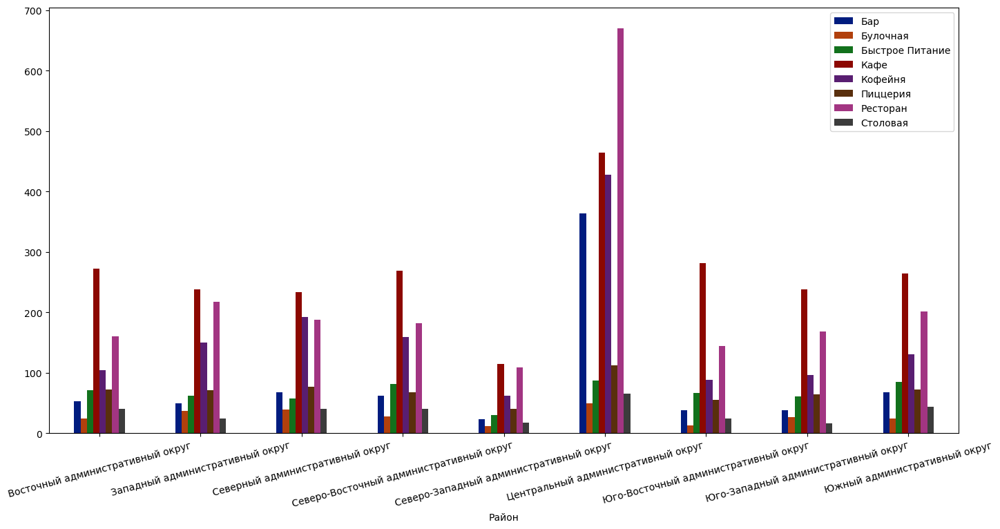

In [83]:
name_by_districts_c.plot(x='Район', 
                         kind='bar', 
                         figsize=(17, 8), 
                         label = 'Распределение количества заведений по категориям и районам Москвы')
sns.set_palette('dark') 
plt.xticks(rotation = 15);

In [84]:
name_by_districts_grouped = pd.pivot_table(data=moscow_places, index=['district', 'category'], values='name', aggfunc=['count'])

name_by_districts_grouped = name_by_districts_grouped.droplevel(level=1, axis=1).sort_values(by='count', ascending=False).reset_index()

display(name_by_districts_grouped);

,district,category,count
0,Центральный административный округ,ресторан,670
1,Центральный административный округ,кафе,464
2,Центральный административный округ,кофейня,428
3,Центральный административный округ,"бар,паб",364
4,Юго-Восточный административный округ,кафе,282
...,...,...,...
67,Северо-Западный административный округ,"бар,паб",23
68,Северо-Западный административный округ,столовая,18
69,Юго-Западный административный округ,столовая,17
70,Юго-Восточный административный округ,булочная,13


In [85]:
fig = px.bar(name_by_districts_grouped, x='count', y='district', color='category')
fig.update_layout(title='Распределение количества заведений по категориям и районам Москвы',
                  xaxis_title='Количество заведений',
                  yaxis_title='Район Москвы',
                  yaxis={'categoryorder': 'total ascending'})
fig.show()

На графике показано распределение заведений в админимтративных районах Москвы, в разбивке по категориям. В ЦАО количество заведений больше, чем в 2 раза превышает количество заведений в любом из отдельных районов города. А количество ркесторанов в ЦАО превышает количество всех заведений в СЗАО.

In [86]:
name_by_districts_grouped_b = name_by_districts_grouped

fig = px.bar(name_by_districts_grouped_b, x='district', y='count', color='category', text='count',
                 width=1000, height=1200)
fig.update_layout(title='Распределение количества заведений по категориям и районам Москвы',
                  xaxis_title='Район Москвы',
                  yaxis_title='Количество заведений',
                  xaxis={'categoryorder': 'total descending'})
fig.show()

На графике выше представлено количество заведений Москвы в разбивке по районам и категориям.

**Визуализируем распределение средних рейтингов по категориям заведений. Сделаем вывод о том, сильно ли различаются усреднённые рейтинги в разных типах общепита.**

In [87]:
rating_by_category = pd.pivot_table(data=moscow_places, index='category', values='rating', aggfunc='mean').sort_values(by='rating', ascending=False).reset_index()

display(rating_by_category);

,category,rating
0,"бар,паб",4.387696
1,пиццерия,4.301264
2,ресторан,4.290402
3,кофейня,4.277282
4,булочная,4.268359
5,столовая,4.211429
6,кафе,4.124285
7,быстрое_питание,4.050249


In [88]:
fig = px.bar(rating_by_category, x='category', y='rating', color_discrete_sequence=["red"])
fig.update_layout(title='Распределение средних рейтингов по категориям заведений',
                  xaxis_title='Категории заведений',
                  yaxis_title='Рейтинг заведений',
                  xaxis={'categoryorder': 'total descending'})

fig.update_yaxes(range = [4, 4.4])
fig.show()

In [89]:
print(f'Средний рейтинг заведений находится в диапазоне от {rating_by_category.rating.min()} до {rating_by_category.rating.max()} баллов. Бары имеют самый высокий средний рейтинг, а заведения быстрого питания - самый низкий.');


Средний рейтинг заведений находится в диапазоне от 4.050248756218906 до 4.387696335078534 баллов. Бары имеют самый высокий средний рейтинг, а заведения быстрого питания - самый низкий.


Можно сказать, что усреднённые рейтинги в разных типах общепита различаются не очень сильно.

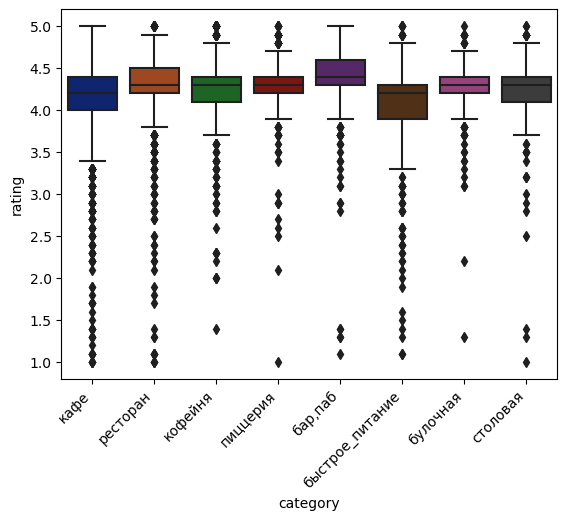

In [90]:
sns.boxplot(x='category', y='rating', data=moscow_places)

plt.xticks(rotation=45, 
           ha='right');

In [91]:
mp_by_rating = moscow_places.sort_values(by='rating', ascending=False)

fig = px.box(mp_by_rating, x='category', y='rating', color_discrete_sequence=["green"])
fig.update_layout(title='Распределение средних рейтингов по категориям заведений',
                  xaxis_title='Категории заведений',
                  yaxis_title='Рейтинг заведений',
                  xaxis={'categoryorder': 'total descending'})

fig.show()

**Построим фоновую картограмму (хороплет) со средним рейтингом заведений каждого района. Границы районов Москвы, которые встречаются в датасете, хранятся в файле admin_level_geomap.geojson.**

In [92]:
# Загружаем JSON-файл с границами округов Москвы
state_geo = 'https://code.s3.yandex.net/data-analyst/admin_level_geomap.geojson'
# moscow_lat - широта центра Москвы, moscow_lng - долгота центра Москвы
moscow_lat, moscow_lng = 55.751244, 37.618423

# Создаём карту Москвы
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)

# Создаём хороплет с помощью конструктора Choropleth и добавляем его на карту
Choropleth(
    geo_data=state_geo,
    data=moscow_places,
    columns=['district', 'rating'],
    key_on='feature.name',
    fill_color='Purples',
    fill_opacity=0.8,
    legend_name='Медианный рейтинг заведений по районам',
).add_to(m).geojson.add_child(GeoJsonTooltip(['name'],labels=False))

# Выводим карту
m

Заведения с самым высоким рейтингом расположены на севере Москвы, с самым низким - на востоке.

**Отобразим все заведения датасета на карте с помощью кластеров средствами библиотеки folium.**

In [93]:
# moscow_lat - широта центра Москвы, moscow_lng - долгота центра Москвы
moscow_lat, moscow_lng = 55.751244, 37.618423

# Создаём карту Москвы
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)
# создаём пустой кластер, добавляем его на карту
marker_cluster = MarkerCluster().add_to(m)

# Пишем функцию, которая принимает строку датафрейма,
# Создаёт маркер в текущей точке и добавляет его в кластер marker_cluster
def create_clusters(row):
    Marker(
        [row['lat'], row['lng']],
        popup=f"{row['name']} {row['rating']}",
    ).add_to(marker_cluster)

# Применяем функцию create_clusters() к каждой строке датафрейма
moscow_places.apply(create_clusters, axis=1)

# Выводим карту
m

**Найдём топ-15 улиц по количеству заведений. Построим график распределения количества заведений и их категорий по этим улицам. Проиллюстрируем эту информацию одним графиком.**

In [94]:
display(moscow_places.head(5));

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24/7,quantity
0,wowфли,кафе,"москва,_улица_дыбенко,_7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,NaN,NaN,NaN,NaN,0,60,улица_дыбенко,False,0
1,четыре_комнаты,ресторан,"москва,_улица_дыбенко,_36,_корп._1",Северный административный округ,"ежедневно, 10:00–22:00",55.875801,37.484479,4.5,выше_среднего,Средний счёт:1500–1600 ₽,1550.0,NaN,0,4,улица_дыбенко,False,1
2,хазри,кафе,"москва,_клязьминская_улица,_15",Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00–02:00",55.889146,37.525901,4.6,средние,Средний счёт:от 1000 ₽,1000.0,NaN,0,45,клязьминская_улица,False,2
3,dormouse_coffee_shop,кофейня,"москва,_улица_маршала_федоренко,_12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,NaN,Цена чашки капучино:155–185 ₽,NaN,170.0,0,80,улица_маршала_федоренко,False,3
4,иль_марко,пиццерия,"москва,_правобережная_улица,_1б",Северный административный округ,"ежедневно, 10:00–22:00",55.881166,37.449357,5.0,средние,Средний счёт:400–600 ₽,500.0,NaN,1,148,правобережная_улица,False,4


In [95]:
streets_top_15 = pd.pivot_table(data=moscow_places, 
                                index='street', 
                                values='name', 
                                aggfunc='count').sort_values(by='name', ascending=False).head(15).reset_index()

display(streets_top_15);

,street,name
0,проспект_мира,183
1,профсоюзная_улица,122
2,проспект_вернадского,108
3,ленинский_проспект,107
4,ленинградский_проспект,95
5,дмитровское_шоссе,88
6,каширское_шоссе,77
7,варшавское_шоссе,76
8,ленинградское_шоссе,70
9,мкад,65


In [96]:
fig = px.bar(streets_top_15, x='street', y='name', text='name', color_discrete_sequence=["yellow"])
fig.update_layout(title='Топ-15 улиц по количеству заведений',
                  xaxis_title='Улица Москвы',
                  yaxis_title='Количество заведений',
                  xaxis={'categoryorder': 'total descending'})
fig.show()

In [97]:
print(f'Топ-15 улиц по количеству заведений:')
print(streets_top_15.street)

Топ-15 улиц по количеству заведений:
0              проспект_мира
1          профсоюзная_улица
2       проспект_вернадского
3         ленинский_проспект
4     ленинградский_проспект
5          дмитровское_шоссе
6            каширское_шоссе
7           варшавское_шоссе
8        ленинградское_шоссе
9                       мкад
10          люблинская_улица
11            улица_вавилова
12      кутузовский_проспект
13      улица_миклухо-маклая
14           пятницкая_улица
Name: street, dtype: object


Можно сделать следующий вывод:

Чем длиннее улица, тем больше на ней умещается заведений. Профсоюзная улица - самая длинная улица Москвы. 😊
Не уверен, что можно считать улицей МКАД, но его длина равна 108 км.
На пятнадцатом месте мы видим Пятницкую улицу - она расположена в ЦАО, а в ЦАО так же самая высокая плотность заведений общественного питания.


**Найдём улицы, на которых находится только один объект общепита. Сделаем вывод о том, что можно сказать об этих заведениях.**

In [98]:
retaurants_by_streets = pd.pivot_table(data=moscow_places, 
                                index='street', 
                                values='name', 
                                aggfunc='count').sort_values(by='name', ascending=False).reset_index()

display(retaurants_by_streets.head(5));

,street,name
0,проспект_мира,183
1,профсоюзная_улица,122
2,проспект_вернадского,108
3,ленинский_проспект,107
4,ленинградский_проспект,95


In [99]:
streets_with_one = retaurants_by_streets[retaurants_by_streets['name'] == 1]

In [100]:
print(f'Количество улиц на которых всего одно заведение общепита равняется: {streets_with_one.name.count()}');

Количество улиц на которых всего одно заведение общепита равняется: 457


In [101]:
display(streets_with_one.head(15));

,street,name
990,улица_вучетича,1
991,улица_олеко_дундича,1
992,электрический_переулок,1
993,улица_конёнкова,1
994,улица_лобачика,1
995,улица_чистова,1
996,улица_высоцкого,1
997,улица_поликарпова,1
998,улица_старые_кузьминки,1
999,федеративный_проспект,1


In [102]:
streets_with_one_rest = moscow_places.groupby(['street', 'category'], as_index=False)\
    .agg(count=('street', 'count'))\
    .query('count == 1')

display(streets_with_one_rest.head(15));

,street,category,count
0,1-й_автозаводский_проезд,кафе,1
1,1-й_балтийский_переулок,ресторан,1
2,1-й_варшавский_проезд,кафе,1
3,1-й_вешняковский_проезд,кафе,1
4,1-й_волоколамский_проезд,кафе,1
5,1-й_волоколамский_проезд,кофейня,1
6,1-й_волоколамский_проезд,ресторан,1
7,1-й_голутвинский_переулок,"бар,паб",1
8,1-й_грайвороновский_проезд,"бар,паб",1
9,1-й_дербеневский_переулок,кафе,1


In [103]:
print(f'На улицах, на которых всего одно заведение, встречаются заведения следующих категорий:')
display(streets_with_one_rest.category.unique())

На улицах, на которых всего одно заведение, встречаются заведения следующих категорий:


array(['кафе', 'ресторан', 'кофейня', 'бар,паб', 'столовая', 'пиццерия',
       'булочная', 'быстрое_питание'], dtype=object)

То есть можно сказать, что на улицах, на которых всего одно заведение, присутствуют заведения всех категорий.

In [104]:
streets_with_one_rest_counts = streets_with_one_rest.category.value_counts()

display(streets_with_one_rest_counts)

кафе               446
кофейня            371
ресторан           357
бар,паб            275
пиццерия           259
быстрое_питание    196
столовая           182
булочная           166
Name: category, dtype: int64

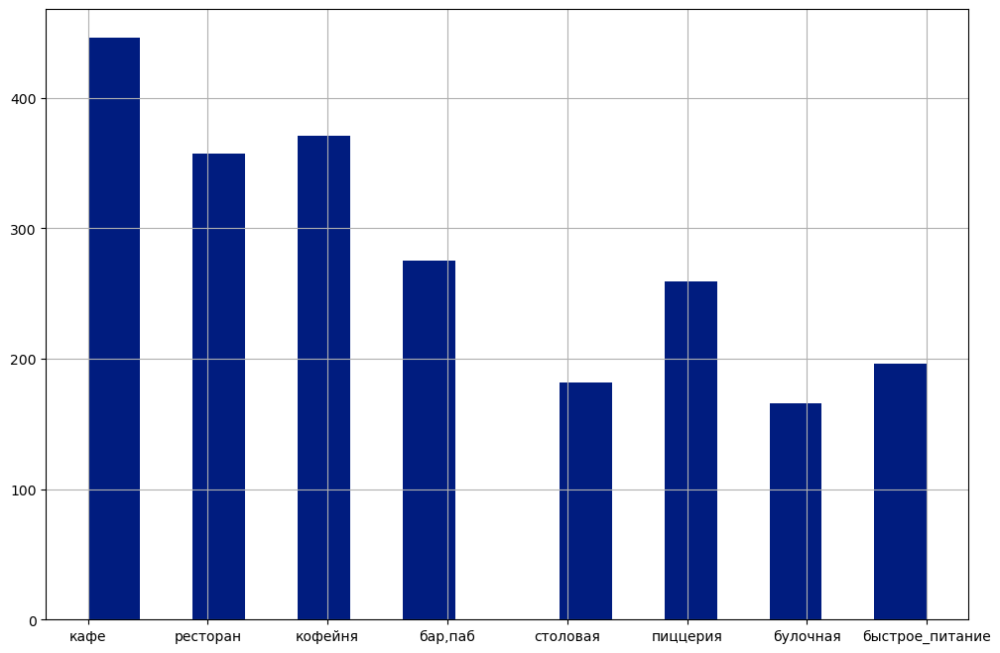

In [105]:
streets_with_one_rest.category.hist(figsize=(12, 8), bins=16);

In [106]:
streets_with_one_rest_counts_n = pd.pivot_table(data=streets_with_one_rest,
                                                index='category',
                                                values='street',
                                                aggfunc='count').sort_values(by='street', ascending=False).reset_index()

display(streets_with_one_rest_counts_n);

,category,street
0,кафе,446
1,кофейня,371
2,ресторан,357
3,"бар,паб",275
4,пиццерия,259
5,быстрое_питание,196
6,столовая,182
7,булочная,166


In [107]:
fig = px.bar(streets_with_one_rest_counts_n, x='category', y='street', color_discrete_sequence=["blue"])
fig.update_layout(title='Распределение заведений, которые единственные на своей улице по категориям',
                  xaxis_title='Категории заведений',
                  yaxis_title='Количество заведений',
                  xaxis={'categoryorder': 'total descending'})

fig.update_yaxes(range=[0, 450])
fig.show()

Можно сказать, что на улицах с одним заведением, большинство заведений относятся к типам - кафе и кофейня, а меньшинство к типу - булочная и столовая.

In [108]:
moscow_streets_with_one_rest = moscow_places.query('street in @streets_with_one.street')

display(moscow_streets_with_one_rest.head(5))

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24/7,quantity
15,дом_обеда,столовая,"москва,_улица_бусиновская_горка,_2",Северный административный округ,пн-пт 08:30–18:30; сб 10:00–20:00,55.885890,37.493264,4.1,средние,Средний счёт:300–500 ₽,400.0,NaN,0,180,улица_бусиновская_горка,False,15
21,7/12,кафе,"москва,_прибрежный_проезд,_7",Северный административный округ,"ежедневно, 10:00–22:00",55.876805,37.464934,4.5,NaN,NaN,NaN,NaN,0,60,прибрежный_проезд,False,21
25,в_парке_вкуснее,кофейня,"москва,_парк_левобережный",Северный административный округ,"ежедневно, 10:00–21:00",55.878453,37.460028,4.3,NaN,NaN,NaN,NaN,1,80,парк_левобережный,False,25
58,coffeekaldi's,кофейня,"москва,_угличская_улица,_13,_стр._8",Северо-Восточный административный округ,"ежедневно, 09:00–22:00",55.900316,37.570558,4.1,средние,Средний счёт:500–800 ₽,650.0,NaN,1,80,угличская_улица,False,58
60,чебуречная_история,кофейня,"москва,_ландшафтный_заказник_лианозовский",Северо-Восточный административный округ,"ежедневно, 10:00–22:00",55.899845,37.570488,4.9,NaN,NaN,NaN,NaN,1,80,ландшафтный_заказник_лианозовский,False,60


In [109]:
# moscow_lat - широта центра Москвы, moscow_lng - долгота центра Москвы
moscow_lat, moscow_lng = 55.751244, 37.618423

# Создаём карту Москвы
o = Map(location=[moscow_lat, moscow_lng], zoom_start=10)
# создаём пустой кластер, добавляем его на карту
marker_cluster = MarkerCluster().add_to(o)

# Пишем функцию, которая принимает строку датафрейма,
# Создаёт маркер в текущей точке и добавляет его в кластер marker_cluster
def create_clusters(row):
    Marker(
        [row['lat'], row['lng']],
        popup=f"{row['name']} {row['rating']}",
    ).add_to(marker_cluster)

# Применяем функцию create_clusters() к каждой строке датафрейма
moscow_streets_with_one_rest.apply(create_clusters, axis=1)

# Выводим карту
o

Еще заметно то, что все эти заведения на улицах только с одним заведением располагаются, в основном на маленьких улочках, проездах, переулках.

**Значения средних чеков заведений хранятся в столбце middle_avg_bill. Эти числа показывают примерную стоимость заказа в рублях, которая чаще всего выражена диапазоном. Посчитаем медиану этого столбца для каждого района. Используем это значение в качестве ценового индикатора района. Построим фоновую картограмму (хороплет) с полученными значениями для каждого района. Проанализируем цены в центральном административном округе и других. Сделаем вывод о том, как удалённость от центра влияет на цены в заведениях.**

In [110]:
display(moscow_places.head(5));

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24/7,quantity
0,wowфли,кафе,"москва,_улица_дыбенко,_7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,NaN,NaN,NaN,NaN,0,60,улица_дыбенко,False,0
1,четыре_комнаты,ресторан,"москва,_улица_дыбенко,_36,_корп._1",Северный административный округ,"ежедневно, 10:00–22:00",55.875801,37.484479,4.5,выше_среднего,Средний счёт:1500–1600 ₽,1550.0,NaN,0,4,улица_дыбенко,False,1
2,хазри,кафе,"москва,_клязьминская_улица,_15",Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00–02:00",55.889146,37.525901,4.6,средние,Средний счёт:от 1000 ₽,1000.0,NaN,0,45,клязьминская_улица,False,2
3,dormouse_coffee_shop,кофейня,"москва,_улица_маршала_федоренко,_12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,NaN,Цена чашки капучино:155–185 ₽,NaN,170.0,0,80,улица_маршала_федоренко,False,3
4,иль_марко,пиццерия,"москва,_правобережная_улица,_1б",Северный административный округ,"ежедневно, 10:00–22:00",55.881166,37.449357,5.0,средние,Средний счёт:400–600 ₽,500.0,NaN,1,148,правобережная_улица,False,4


In [111]:
districts_by_avgbill = pd.pivot_table(data=moscow_places, 
                                index='district', 
                                values='middle_avg_bill', 
                                aggfunc='median').sort_values(by='middle_avg_bill', ascending=False).reset_index()

display(districts_by_avgbill);

,district,middle_avg_bill
0,Западный административный округ,1000.0
1,Центральный административный округ,1000.0
2,Северо-Западный административный округ,700.0
3,Северный административный округ,650.0
4,Юго-Западный административный округ,600.0
5,Восточный административный округ,575.0
6,Северо-Восточный административный округ,500.0
7,Южный административный округ,500.0
8,Юго-Восточный административный округ,450.0


In [112]:
fig = px.bar(districts_by_avgbill, x='district', y='middle_avg_bill', text='middle_avg_bill', color_discrete_sequence=["green"])
fig.update_layout(title='Медианная стоимость среднего чека для каждого района',
                  xaxis_title='Район Москвы',
                  yaxis_title='Медианный чек',
                  xaxis={'categoryorder': 'total descending'})
fig.show()

In [113]:
fig = px.box(moscow_places, x='district', y='middle_avg_bill', color_discrete_sequence=["black"],
                 width=1000, height=1200)
fig.update_layout(title='Медианная стоимость среднего чека для каждого района',
                  xaxis_title='Район Москвы',
                  yaxis_title='Медианный чек',
                  xaxis={'categoryorder': 'total descending'})
fig.update_yaxes(range = [0, 12000])
fig.show()

На графике выше можно посмотреть на количество выбросов и на то, насколько большими бывают чеки в различных районах города.

В Северном и Восточном округах есть заведения, которым повезло с клиентами.

In [114]:
fig = px.box(moscow_places, x='district', y='middle_avg_bill', color_discrete_sequence=["black"],
                 width=1000, height=1200)
fig.update_layout(title='Медианная стоимость среднего чека для каждого района',
                  xaxis_title='Район Москвы',
                  yaxis_title='Медианный чек',
                  xaxis={'categoryorder': 'total descending'})
fig.update_yaxes(range = [0, 3500])
fig.show()

На графике выше можно посмотреть разброс чеков в различных районах Москвы и медианные чеки.

In [115]:
# Загружаем JSON-файл с границами округов Москвы
state_geo = 'https://code.s3.yandex.net/data-analyst/admin_level_geomap.geojson'
# moscow_lat - широта центра Москвы, moscow_lng - долгота центра Москвы
moscow_lat, moscow_lng = 55.751244, 37.618423

# Создаём карту Москвы
n = Map(location=[moscow_lat, moscow_lng], zoom_start=10)

# Создаём хороплет с помощью конструктора Choropleth и добавляем его на карту
Choropleth(
    geo_data=state_geo,
    data=districts_by_avgbill,
    columns=['district', 'middle_avg_bill'],
    key_on='feature.name',
    fill_color='PuBu',
    fill_opacity=0.8,
    legend_name='Медианный рейтинг заведений по районам',
).add_to(n).geojson.add_child(GeoJsonTooltip(['name'],labels=False))

# Выводим карту
n

На хороплете видно распределение медианных чеков по районам на карте. 

На севере и на юге самые низкие средние чеки, в Центре и на западе - самые высокие.

**Соберём наблюдения по вопросам выше в один общий вывод.**

**Общий вывод по части Анализ данных:**

При проведении анализа датасета были выявлены следующие закономерности на рынке общественного питания в городе Москва:э

* Видно, что больше кафе, ресторанов и кофеен, а меньше булочных, столовых и заведений быстрого питания.
* Самым популярным типом заведений является кафе, самым менее популярным - булочная.
* Самое большое медианное значение количества посадочных мест в ресторанах, самое меньшее в булочных.
* Не сетевых заведений больше, чем сетевых.
* Чаще сетевыми являются кафе, рестораны, кофейни и бары.
* По диаграмме видно, что больше всего заведений называются "Кафе" - их 188 штук или 19% от общего количества в Топ-15. На 15-м месте нашего топа находятся заведения с названием "Ресторан" - 34 заведения или 3,43% от Топ-15. Заведения общественного питания из Топ-15 по городу Москва, в основном, относятся к достаточно известным сетям.
* На диаграмме видно, что большую долю по количеству заведений в городе занимает ЦАО, меньшую - СЗАО.
* В ЦАО количество заведений больше, чем в 2 раза превышает количество заведений в любом из отдельных районов города. А количество ркесторанов в ЦАО превышает количество всех заведений в СЗАО.
* Средний рейтинг заведений находится в диапазоне от 4.05 до 4.39 баллов. Бары имеют самый высокий средний рейтинг, а заведения быстрого питания - самый низкий.
* Можно сказать, что усреднённые рейтинги в разных типах общепита различаются не очень сильно.
* Заведения с самым высоким рейтингом расположены на севере Москвы, с самым низким - на востоке.
* Можно сказать, что на улицах с одним заведением, большинство заведений относятся к типам - кафе и кофейня, а меньшинство к типу - булочная и столовая.
* Заметно то, что все эти заведения на улицах только с одним заведением располагаются, в основном на маленьких улочках, проездах, переулках.
* На севере и на юге самые низкие средние чеки, в Центре и на западе - самые высокие.


Другими словами можно сделать вывод о том, что самыми популярными заведениями общественного питания в Москве являются кафе и кофейни и кафе чаще являются сетевыми. Сетевые заведения часто достаточно известные. Меньше всего заведений в СЗАО, больше в ЦАО. Средний рейтинг заведений различного типа отличается не сильно. Кафе и кофейни часто располагаются на небольших улочках, проездах, переулках. В ЦАО и ЗАО самые высокие средние чеки.

### Детализируем исследование: открытие кофейни

Основателям фонда «Shut Up and Take My Money» не даёт покоя успех сериала «Друзья». Их мечта — открыть такую же крутую и доступную, как «Central Perk», кофейню в Москве. Будем считать, что заказчики не боятся конкуренции в этой сфере, ведь кофеен в больших городах уже достаточно. Попробуйте определить, осуществима ли мечта клиентов.

**Сделаем вывод о том, сколько всего кофеен в датасете. В каких районах их больше всего, каковы особенности их расположения.**

In [116]:
coffee_houses = moscow_places[moscow_places['category']=='кофейня'].reset_index(drop=True)

display(coffee_houses.head(5))

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24/7,quantity
0,dormouse_coffee_shop,кофейня,"москва,_улица_маршала_федоренко,_12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,NaN,Цена чашки капучино:155–185 ₽,NaN,170.0,0,80,улица_маршала_федоренко,False,3
1,в_парке_вкуснее,кофейня,"москва,_парк_левобережный",Северный административный округ,"ежедневно, 10:00–21:00",55.878453,37.460028,4.3,NaN,NaN,NaN,NaN,1,80,парк_левобережный,False,25
2,9_bar_coffee,кофейня,"москва,_коровинское_шоссе,_41,_стр._1",Северный административный округ,пн-пт 08:00–18:00,55.885837,37.513422,4.0,NaN,NaN,NaN,NaN,1,46,коровинское_шоссе,False,45
3,cofefest,кофейня,"москва,_улица_маршала_федоренко,_6с1",Северный административный округ,пн-пт 09:00–19:00,55.879934,37.492522,3.6,NaN,NaN,NaN,NaN,1,80,улица_маршала_федоренко,False,46
4,cofix,кофейня,"москва,_улица_дыбенко,_7/1",Северный административный округ,"ежедневно, 08:00–22:00",55.878531,37.479395,3.8,NaN,NaN,NaN,NaN,1,80,улица_дыбенко,False,52


Кофейни располагаются в следующих местах:

In [117]:
# moscow_lat - широта центра Москвы, moscow_lng - долгота центра Москвы
moscow_lat, moscow_lng = 55.751244, 37.618423

# Создаём карту Москвы
p = Map(location=[moscow_lat, moscow_lng], zoom_start=10)
# Создаём пустой кластер, добавляем его на карту
marker_cluster = MarkerCluster().add_to(p)

# Пишем функцию, которая принимает строку датафрейма,
# Создаёт маркер в текущей точке и добавляет его в кластер marker_cluster
def create_clusters(row):
    Marker(
        [row['lat'], row['lng']],
        popup=f"{row['name']} {row['rating']}",
    ).add_to(marker_cluster)

# Применяем функцию create_clusters() к каждой строке датафрейма
coffee_houses.apply(create_clusters, axis=1)

# Выводим карту
p

In [118]:
coffee_houses_by_districts = pd.pivot_table(data=coffee_houses, 
                                            index='district', 
                                            values='name',
                                            aggfunc='count').sort_values(by='name',ascending=False).reset_index()
display(coffee_houses_by_districts);

,district,name
0,Центральный административный округ,428
1,Северный административный округ,193
2,Северо-Восточный административный округ,159
3,Западный административный округ,150
4,Южный административный округ,131
5,Восточный административный округ,105
6,Юго-Западный административный округ,96
7,Юго-Восточный административный округ,89
8,Северо-Западный административный округ,62


In [119]:
# загружаем JSON-файл с границами округов Москвы
state_geo = 'https://code.s3.yandex.net/data-analyst/admin_level_geomap.geojson'
# moscow_lat - широта центра Москвы, moscow_lng - долгота центра Москвы
moscow_lat, moscow_lng = 55.751244, 37.618423

# создаём карту Москвы
s = Map(location=[moscow_lat, moscow_lng], zoom_start=10)

# создаём хороплет с помощью конструктора Choropleth и добавляем его на карту
Choropleth(
    geo_data=state_geo,
    data=coffee_houses_by_districts,
    columns=['district', 'name'],
    key_on='feature.name',
    fill_color='PuBu',
    fill_opacity=0.8,
    legend_name='Распределение кофеен по районам',
).add_to(s).geojson.add_child(GeoJsonTooltip(['name'],labels=False))

# выводим карту
s

На карте выше видно, что самая высокая плотность кофеен в ЦАО. В СЗАО она ниже.

In [120]:
fig = px.bar(coffee_houses_by_districts, x='district', y='name', color_discrete_sequence=["blue"])
fig.update_layout(title='Распределение кофеен по районам',
                  xaxis_title='Район города',
                  yaxis_title='Рейтинг заведений',
                  xaxis={'categoryorder': 'total descending'})

fig.update_yaxes(range = [0, 450])
fig.show()

Больше всего кофеен находится в ЦАО, меньше всего в СЗАО.

In [121]:
print(f'Кофеен в  Москве всего {coffee_houses_by_districts.name.sum()}')

Кофеен в  Москве всего 1413


**Сделаем вывод о том, есть ли круглосуточные кофейни?**

In [122]:
coffee_houses_24 = coffee_houses[coffee_houses['is_24/7']==True].reset_index(drop=True)

display(coffee_houses_24.head(5))

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24/7,quantity
0,wild_bean,кофейня,"москва,_дмитровское_шоссе,_107е",Северный административный округ,"ежедневно, круглосуточно",55.878477,37.543426,3.5,NaN,NaN,NaN,NaN,1,20,дмитровское_шоссе,True,200
1,wild_bean_cafe,кофейня,"москва,_ярославское_шоссе,_116",Северо-Восточный административный округ,"ежедневно, круглосуточно",55.867822,37.708853,4.0,NaN,NaN,NaN,NaN,1,25,ярославское_шоссе,True,971
2,wild_bean_cafe,кофейня,"москва,_ярославское_шоссе,_вл3с3",Северо-Восточный административный округ,"ежедневно, круглосуточно",55.851778,37.676423,4.5,NaN,Цена чашки капучино:140–200 ₽,NaN,170.0,1,80,ярославское_шоссе,True,1047
3,wild_bean_cafe,кофейня,"москва,_мкад,_65-й_километр,_8",Северо-Западный административный округ,"ежедневно, круглосуточно",55.813787,37.390701,4.3,NaN,NaN,NaN,NaN,1,80,мкад,True,1214
4,шоколадница,кофейня,"москва,_улица_народного_ополчения,_49,_корп._1",Северо-Западный административный округ,"ежедневно, круглосуточно",55.794815,37.494834,4.2,средние,Средний счёт:650–850 ₽,750.0,NaN,1,200,улица_народного_ополчения,True,1291


In [123]:
print(f'Количество круглосуточных кофеен равняется {coffee_houses_24.name.count()}')

Количество круглосуточных кофеен равняется 59


**Сделаем вывод о том, какие у кофеен рейтинги и как кофейни распределяются по районам.**

In [124]:
print('Рейтинги кофеен могут быть следующими:')

display(coffee_houses.rating.unique());

Рейтинги кофеен могут быть следующими:


array([5. , 4.3, 4. , 3.6, 3.8, 3.1, 4.1, 4.9, 4.8, 4.5, 4.4, 4.2, 2.9,
       3.5, 4.6, 3.9, 4.7, 2.2, 2. , 3. , 3.7, 3.2, 2.3, 1.4, 2.6, 3.3,
       3.4, 2.8])

In [125]:
print(f'И находиться в пределах от {coffee_houses.rating.min()} до {coffee_houses.rating.max()}')

И находиться в пределах от 1.4 до 5.0


In [126]:
coffee_houses_ratints = pd.pivot_table(data=coffee_houses, 
                                       index='district', 
                                       values='rating', 
                                       aggfunc='median').sort_values(by='rating', ascending=False).reset_index()
display(coffee_houses_ratints);

,district,rating
0,Восточный административный округ,4.3
1,Северный административный округ,4.3
2,Северо-Восточный административный округ,4.3
3,Северо-Западный административный округ,4.3
4,Центральный административный округ,4.3
5,Юго-Восточный административный округ,4.3
6,Юго-Западный административный округ,4.3
7,Южный административный округ,4.3
8,Западный административный округ,4.2


In [127]:
fig = px.bar(coffee_houses_ratints, x='district', y='rating', color_discrete_sequence=["yellow"])
fig.update_layout(title='Распределение средних рейтингов кофеенпо районам',
                  xaxis_title='Категории заведений',
                  yaxis_title='Рейтинг заведений',
                  xaxis={'categoryorder': 'total descending'})

fig.update_yaxes(range = [4.1, 4.4])
fig.show()

Самый низкий средний рейтинг у заведений из ЗАО, по остальным районам средний рейтинг равен 4.3.

**Сделаем вывод о том, какую стоимость чашки капучино стоит ориентироваться при открытии и почему.**

In [128]:
coffee_cup_avg = pd.pivot_table(data=coffee_houses, 
                                index='district', 
                                values='middle_coffee_cup', 
                                aggfunc='median').sort_values(by='middle_coffee_cup', ascending=False).reset_index()

display(coffee_cup_avg);

,district,middle_coffee_cup
0,Юго-Западный административный округ,198.0
1,Центральный административный округ,190.0
2,Западный административный округ,189.0
3,Северо-Западный административный округ,165.0
4,Северо-Восточный административный округ,162.5
5,Северный административный округ,159.0
6,Южный административный округ,150.0
7,Юго-Восточный административный округ,147.5
8,Восточный административный округ,135.0


In [129]:
fig = px.bar(coffee_cup_avg, x='district', y='middle_coffee_cup', color_discrete_sequence=["blue"])
fig.update_layout(title='Распределение средней стоимости чашки капучино по районам',
                  xaxis_title='Районы Москвы',
                  yaxis_title='Средняя стоимость чашки капучино',
                  xaxis={'categoryorder': 'total descending'})

fig.update_yaxes(range = [100, 200])
fig.show()

In [130]:
# Загружаем JSON-файл с границами округов Москвы
state_geo = 'https://code.s3.yandex.net/data-analyst/admin_level_geomap.geojson'
# moscow_lat - широта центра Москвы, moscow_lng - долгота центра Москвы
moscow_lat, moscow_lng = 55.751244, 37.618423

# Создаём карту Москвы
r = Map(location=[moscow_lat, moscow_lng], zoom_start=10)

# Создаём хороплет с помощью конструктора Choropleth и добавляем его на карту
Choropleth(
    geo_data=state_geo,
    data=coffee_cup_avg,
    columns=['district', 'middle_coffee_cup'],
    key_on='feature.name',
    fill_color='YlOrBr',
    fill_opacity=0.8,
    legend_name='Медианный рейтинг заведений по районам',
).add_to(r).geojson.add_child(GeoJsonTooltip(['name'],labels=False))

# Выводим карту
r

По карте выше вижно в каких районах средняя стоимость кофе дороже, а в каких дешевле.

Из анализа выше видно, что в ЮЗАО плотность кофеен ниже чем, в ЦАО и ЗАО и, при всём этом средняя стоимость чашки кофе выше, чем в ЦАО и ЗАО. Думаю, что ЮЗАО - благоприятное место для открытия кофейни. Предлагаю установить среднюю стоимость чашки капучино в нашей кофейне равной 190Р - это значение немного ниже среднего.

###  Подготовка презентации

Презентация: <https://disk.yandex.ru/i/YjKuY39EJ400zA> 